<a href="https://colab.research.google.com/github/reddy88/Coding-Raja-Internships/blob/main/Food_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q datasets transformers
import os

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 527.3/527.3 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.8 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
ibis-framework 8.0.0 requires pyarrow<16,>=2, but you have pyarrow 17.0.0 which is incompatible.


In [ ]:
from huggingface_hub import notebook_login

notebook_login()

In [ ]:
%%capture
!sudo apt -qq install git-lfs
!git config --global credential.helper store

In [ ]:
#Mount your google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Make sure you have a zipped file of the Kaggle datasets in the location
!ls -al "/content/drive/MyDrive/"

total 1554069
drwx------ 2 root root       4096 Aug  1 13:58 'archive (1)'
drwx------ 2 root root       4096 Oct 18  2023 'Colab Notebooks'
-rw------- 1 root root        177 Feb 25 16:43 'Course 1 glossary.gdoc'
-rw------- 1 root root        201 May 25 14:26 'Cybersecurity incident report network traffic analysis.gdoc'
-rw------- 1 root root        201 Jul 21 17:00 'File permissions in Linux.gdoc'
-rw------- 1 root root 1588604321 Aug 14 19:31  FoodClassification.zip
drwx------ 2 root root       4096 Sep  5  2023 'HangMan Game'
-rw------- 1 root root        177 Jan 23  2024  maths.gdoc
drwx------ 2 root root       4096 Sep  5  2023  Placement
-rw------- 1 root root    2375083 Sep  4  2023 'PPT (1).pptx'
-rw------- 1 root root     251426 Sep  5  2023  PPT.pptx
-rw------- 1 root root     112448 Apr 24  2023  RESUME.pdf
drwx------ 2 root root       4096 Aug  1 13:58 'TMDB Dataset'


In [ ]:
!unzip "/content/drive/MyDrive/FoodClassification.zip" -d /tmp/foodimg

Streaming output truncated to the last 5000 lines.
  inflating: /tmp/foodimg/Food Classification/chapati/253.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/254.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/255.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/256.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/257.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/258.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/259.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/260.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/261.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/262.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/263.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/264.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/265.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati/266.jpg  
  inflating: /tmp/foodimg/Food Classification/chapati

We will use the Datasets library's [ImageFolder](https://huggingface.co/docs/datasets/v2.0.0/en/image_process#imagefolder) feature to download our custom dataset into a DatasetDict.

In [ ]:
from datasets import load_dataset
ds = load_dataset("imagefolder", data_dir="/tmp/foodimg")
ds = ds['train']

Resolving data files:   0%|          | 0/6271 [00:00<?, ?it/s]

In [ ]:
# randomly created a test split to validate the model
data = ds.train_test_split(test_size=0.15)

In [ ]:
data.push_to_hub("nurizz/indian_food_images")

Uploading the dataset shards:   0%|          | 0/3 [00:00<?, ?it/s]

Map:   0%|          | 0/1776 [00:00<?, ? examples/s]

Creating parquet from Arrow format:   0%|          | 0/18 [00:00<?, ?ba/s]

Map:   0%|          | 0/1776 [00:00<?, ? examples/s]

Creating parquet from Arrow format:   0%|          | 0/18 [00:00<?, ?ba/s]

Map:   0%|          | 0/1776 [00:00<?, ? examples/s]

Creating parquet from Arrow format:   0%|          | 0/18 [00:00<?, ?ba/s]

Uploading the dataset shards:   0%|          | 0/1 [00:00<?, ?it/s]

Map:   0%|          | 0/941 [00:00<?, ? examples/s]

Creating parquet from Arrow format:   0%|          | 0/10 [00:00<?, ?ba/s]

CommitInfo(commit_url='https://huggingface.co/datasets/nurizz/indian_food_images/commit/d4e4bb62e3bbe25853750f963f686448009a476c', commit_message='Upload dataset', commit_description='', oid='d4e4bb62e3bbe25853750f963f686448009a476c', pr_url=None, pr_revision=None, pr_num=None)

In [ ]:
data = load_dataset("nurizz/indian_food_images")

Generating train split:   0%|          | 0/5328 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/941 [00:00<?, ? examples/s]

In [ ]:
# Sample
ex = data['train'][300]
ex

{'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1280x720>,
 'label': 2}

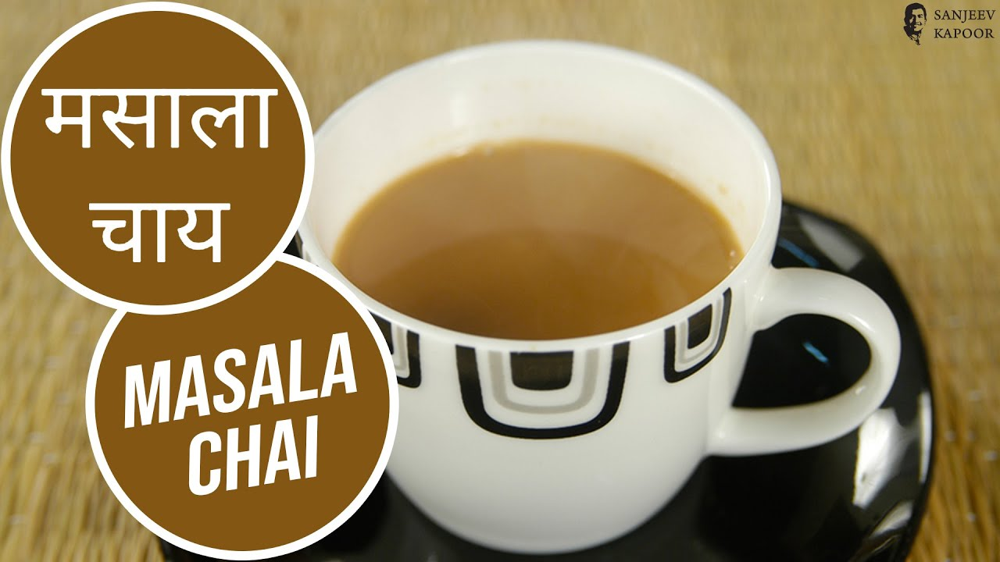

In [ ]:
image = ex['image']
image

In [ ]:
labels = data['train'].features['label']
labels

ClassLabel(names=['burger', 'butter_naan', 'chai', 'chapati', 'chole_bhature', 'dal_makhani', 'dhokla', 'fried_rice', 'idli', 'jalebi', 'kaathi_rolls', 'kadai_paneer', 'kulfi', 'masala_dosa', 'momos', 'paani_puri', 'pakode', 'pav_bhaji', 'pizza', 'samosa'], id=None)

In [ ]:
labels.int2str(ex['label'])

'chai'

# Fine-Tuning
fine-tuning one of the [🤗 Transformers](https://github.com/huggingface/transformers) vision models on the Indian Food dataset.


In [ ]:
from datasets import load_metric

metric = load_metric("accuracy")

<ipython-input-22-350fcae91df9>:3: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  metric = load_metric("accuracy")


The repository for accuracy contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/accuracy.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


The `dataset` object itself is a [`DatasetDict`](https://huggingface.co/docs/datasets/package_reference/main_classes.html#datasetdict), which contains one key per split (in this case, only "train" for a training split).

In [ ]:
data

DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 5328
    })
    test: Dataset({
        features: ['image', 'label'],
        num_rows: 941
    })
})

Here we've created an `id2label` dictionary to decode them back to strings and see what they are. The inverse `label2id` will be useful too, when we load the model later.

In [ ]:
labels = data["train"].features["label"].names
label2id, id2label = dict(), dict()
for i, label in enumerate(labels):
    label2id[label] = i
    id2label[i] = label

# Pre-Processing

Before we can feed these images to our model, we need to preprocess them.

Preprocessing images typically involves (1) resizing them to a particular size (2) normalizing the color channels (R,G,B) using a mean and standard deviation. These are referred to as **image transformations**.

In addition, the one we typically perform **data augmentation** during training (like random cropping and flipping) to make the model more robust and achieve higher accuracy. Data augmentation is also a great technique to increase the size of the training data.

To make sure that we've (1) resize to the appropriate size (2) use the appropriate image mean and standard deviation for the model architecture I am going to use,`AutoFeatureExtractor.from_pretrained` method. This feature extractor is a minimal preprocessor that can be used to prepare images for inference.

In [ ]:
from transformers import ViTFeatureExtractor

model_name_or_path = 'google/vit-base-patch16-224-in21k'
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)

In [ ]:
# print(feature_extractor.size)

In [ ]:
from torchvision.transforms import (
    CenterCrop,
    Compose,
    Normalize,
    RandomHorizontalFlip,
    RandomResizedCrop,
    Resize,
    ToTensor,
)

normalize = Normalize(mean=feature_extractor.image_mean, std=feature_extractor.image_std)

train_transforms = Compose(
    [
        RandomResizedCrop((feature_extractor.size['height'], feature_extractor.size['width'])),
        RandomHorizontalFlip(),
        ToTensor(),
        normalize,
    ]
)

resize_size = (feature_extractor.size["height"], feature_extractor.size["width"]) if isinstance(feature_extractor.size, dict) else feature_extractor.size

val_transforms = Compose(
    [
        Resize(resize_size),
        CenterCrop(resize_size),
        ToTensor(),
        normalize,
    ]
)

def preprocess_train(example_batch):
    """Apply train_transforms across a batch."""
    example_batch["pixel_values"] = [
        train_transforms(image.convert("RGB")) for image in example_batch["image"]
    ]
    return example_batch

def preprocess_val(example_batch):
    """Apply val_transforms across a batch."""
    example_batch["pixel_values"] = [
        val_transforms(image.convert("RGB")) for image in example_batch["image"]
    ]
    return example_batch


Next, we can preprocess our dataset by applying these above functions. We can use the `set_transform` functionality, which allows us to apply the functions above on-the-fly (meaning that they will only be applied when the images are loaded in RAM).

In [ ]:
# spliting up training into training + validation
train_ds = data['train']
val_ds = data['test']

In [ ]:
train_ds.set_transform(preprocess_train)
val_ds.set_transform(preprocess_val)

Let's access an element to see that we've added a "pixel_values" feature:

In [ ]:
train_ds[0]

{'image': <PIL.Image.Image image mode=RGB size=768x512>,
 'label': 3,
 'pixel_values': tensor([[[ 0.4510,  0.4510,  0.4510,  ...,  0.3569,  0.2784,  0.0353],
          [ 0.4510,  0.4588,  0.4431,  ...,  0.3804,  0.3882,  0.3098],
          [ 0.4510,  0.4667,  0.4588,  ...,  0.3882,  0.3804,  0.4039],
          ...,
          [ 0.2706,  0.3176,  0.3333,  ...,  0.1843,  0.1922,  0.2078],
          [ 0.1765,  0.2314,  0.2706,  ...,  0.2000,  0.2078,  0.2235],
          [ 0.1137,  0.1529,  0.1922,  ...,  0.2078,  0.2235,  0.2314]],
 
         [[-0.3647, -0.3647, -0.3725,  ..., -0.3647, -0.4039, -0.6157],
          [-0.3725, -0.3647, -0.3725,  ..., -0.3725, -0.3412, -0.3961],
          [-0.3725, -0.3569, -0.3647,  ..., -0.3725, -0.3804, -0.3490],
          ...,
          [ 0.0510,  0.1137,  0.1608,  ..., -0.4667, -0.4588, -0.4431],
          [-0.0588,  0.0039,  0.0745,  ..., -0.4510, -0.4431, -0.4275],
          [-0.1373, -0.0824, -0.0275,  ..., -0.4431, -0.4275, -0.4196]],
 
         [[-0.

# Training the model

Now the data is ready, we can download the pretrained model and fine-tune it. For classification we use the `AutoModelForImageClassification` class. Calling the `from_pretrained` method on it will download and cache the weights for us. As the label ids and the number of labels are dataset dependent, we pass `label2id`, and `id2label` alongside the `model_checkpoint` here. This will make sure a custom classification head will be created (with a custom number of output neurons).

In [ ]:
from transformers import ViTForImageClassification
model_name_or_path = 'google/vit-base-patch16-224-in21k'
model = ViTForImageClassification.from_pretrained(
    model_name_or_path,
    num_labels=len(labels),
    id2label={str(i): c for i, c in enumerate(labels)},
    label2id={c: str(i) for i, c in enumerate(labels)}
)

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


The warning is telling us we are throwing away some weights (the weights and bias of the `classifier` layer) and randomly initializing some other (the weights and bias of a new `classifier` layer). This is expected in this case, because we are adding a new head for which we don't have pretrained weights, so the library warns us we should fine-tune this model before using it for inference, which is exactly what we are going to do.

To instantiate a `Trainer`, we will need to define the training configuration and the evaluation metric. The most important is the [`TrainingArguments`](https://huggingface.co/transformers/main_classes/trainer.html#transformers.TrainingArguments), which is a class that contains all the attributes to customize the training. It requires one folder name, which will be used to save the checkpoints of the model.

Here  `remove_unused_columns=False` will drop any features not used by the model's call function. By default it's `True` because usually it's ideal to drop unused feature columns, making it easier to unpack inputs into the model's call function. But, in our case, we need the unused features ('image' in particular) in order to create 'pixel_values'.

In [ ]:
from transformers import TrainingArguments

training_args = TrainingArguments(
    'finetuned-indian-food',
  per_device_train_batch_size=16,
  evaluation_strategy="steps",
  num_train_epochs=4,
  fp16=True,
  save_steps=100,
  eval_steps=100,
  logging_steps=10,
  learning_rate=2e-4,
  save_total_limit=2,
  remove_unused_columns=False,
  push_to_hub=True,
  report_to='tensorboard',
  load_best_model_at_end=True,
  hub_strategy="end"
)#

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1494: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Here I have set the evaluation to be done at the end of each epoch, tweak the learning rate, use the `batch_size` defined at the top of the notebook and customize the number of epochs for training, as well as the weight decay. Since the best model might not be the one at the end of training, we ask the `Trainer` to load the best model it saved (according to `metric_name`) at the end of training.

Next, I have defined a function for how to compute the metrics from the predictions, which will just use the `metric` that I have loaded earlier. The only preprocessing that need to be done is to take the argmax of the predicted logits:

In [ ]:
import numpy as np

# the compute_metrics function takes a Named Tuple as input:
# predictions, which are the logits of the model as Numpy arrays,
# and label_ids, which are the ground-truth labels as Numpy arrays.
def compute_metrics(eval_pred):
    """Computes accuracy on a batch of predictions"""
    predictions = np.argmax(eval_pred.predictions, axis=1)
    return metric.compute(predictions=predictions, references=eval_pred.label_ids)

Also defined a `collate_fn` function, which will be used to batch examples together.
Each batch consists of 2 keys, namely `pixel_values` and `labels`.

In [ ]:
import torch

def collate_fn(batch):
    return {
        'pixel_values': torch.stack([x['pixel_values'] for x in batch]),
        'labels': torch.tensor([x['label'] for x in batch])
    }

Then I haved passed all of this along with the datasets to the `Trainer`:

In [ ]:
from transformers import Trainer
trainer = Trainer(
    model,
    training_args,
    train_dataset=train_ds,
    eval_dataset=val_ds,
    tokenizer=feature_extractor,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

Now we can finetune our model by calling the `train` method:

In [ ]:
train_results = trainer.train()
# rest is optional but nice to have
trainer.save_model()
trainer.log_metrics("train", train_results.metrics)
trainer.save_metrics("train", train_results.metrics)
trainer.save_state()

Step,Training Loss,Validation Loss,Accuracy
100,1.109200,1.000680,0.822529
200,0.767700,0.642667,0.853348
300,0.780800,0.578964,0.853348
400,0.362800,0.505060,0.862912
500,0.292800,0.381515,0.908608
600,0.329300,0.352156,0.906482
700,0.223900,0.332029,0.908608
800,0.288000,0.352049,0.906482
900,0.320900,0.284155,0.929862
1000,0.187000,0.257672,0.935175


Upload 3 LFS files:   0%|          | 0/3 [00:00<?, ?it/s]

training_args.bin:   0%|          | 0.00/5.11k [00:00<?, ?B/s]

events.out.tfevents.1723665992.3ebd4a7f7818.229.0:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/343M [00:00<?, ?B/s]

***** train metrics *****
  epoch                    =          4.0
  total_flos               = 1538336014GF
  train_loss               =       0.4768
  train_runtime            =   0:20:44.27
  train_samples_per_second =       17.128
  train_steps_per_second   =        1.071


We can check with the `evaluate` method that our `Trainer` did reload the best model properly (if it was not the last one):

In [ ]:
metrics = trainer.evaluate()
trainer.log_metrics("eval", metrics)
trainer.save_metrics("eval", metrics)

***** eval metrics *****
  epoch                   =        4.0
  eval_accuracy           =     0.9458
  eval_loss               =     0.2206
  eval_runtime            = 0:00:25.60
  eval_samples_per_second =     36.751
  eval_steps_per_second   =      4.609


The model has been trained and to upload the result of the training to the Hub, we can just execute this below instruction:

In [ ]:
kwargs = {
    "finetuned_from": model.config._name_or_path,
    "tasks": "image-classification",
    "dataset": 'indian_food_images',
    "tags": ['image-classification'],
}

if training_args.push_to_hub:
    trainer.push_to_hub('🍻 cheers', **kwargs)
else:
    trainer.create_model_card(**kwargs)

Now anybody can acces this model: they can all load it with the identifier `"your-username/the-name-you-picked"` so for example:

```python
from transformers import AutoModelForImageClassification, AutoFeatureExtractor

feature_extractor = AutoFeatureExtractor.from_pretrained("nurizz/finetuned-indian-food")
model = AutoModelForImageClassification.from_pretrained("nurizz/finetuned-indian-food")

```

## Inference

Let's say you have a new image, on which you'd like to make a prediction. Let's load a image of XYZ and see how the model does.

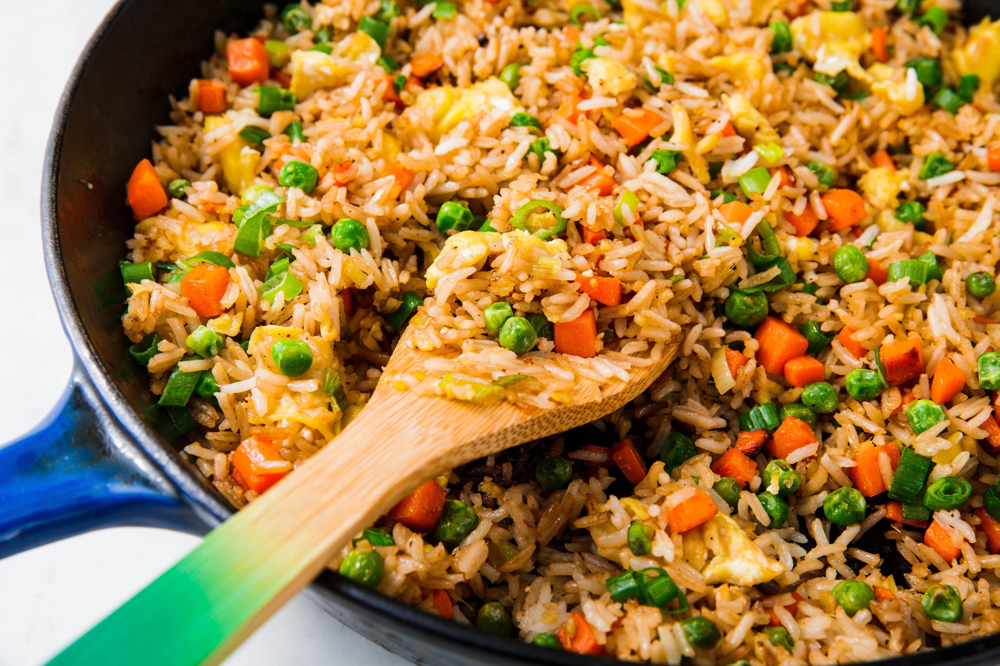

In [ ]:
from PIL import Image
import requests

url = 'https://huggingface.co/nurizz/finetuned-indian-food/resolve/main/003.jpg'
image = Image.open(requests.get(url, stream=True).raw)
image

In [ ]:
from transformers import AutoModelForImageClassification, AutoFeatureExtractor

repo_name = "nurizz/finetuned-indian-food"

feature_extractor = AutoFeatureExtractor.from_pretrained(repo_name)
model = AutoModelForImageClassification.from_pretrained(repo_name)

In [ ]:
# prepare image for the model
encoding = feature_extractor(image.convert("RGB"), return_tensors="pt")
print(encoding.pixel_values.shape)

torch.Size([1, 3, 224, 224])


In [ ]:
import torch

# forward pass
with torch.no_grad():
  outputs = model(**encoding)
  logits = outputs.logits

In [ ]:
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

Predicted class: fried_rice


# Pipeline API

An alternative way to quickly perform inference with any model on the hub is by leveraging the [Pipeline API](https://huggingface.co/docs/transformers/main_classes/pipelines), which abstracts away all the steps we did manually above for us. It will perform the preprocessing, forward pass and postprocessing all in a single object.

For instance:

In [ ]:
from transformers import pipeline
pipe = pipeline("image-classification", "nurizz/finetuned-indian-food")

Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.


In [ ]:
url = 'https://huggingface.co/nurizz/finetuned-indian-food/resolve/main/003.jpg'
image = Image.open(requests.get(url, stream=True).raw)

pipe(image)

[{'label': 'fried_rice', 'score': 0.9858972430229187},
 {'label': 'chapati', 'score': 0.0014400819782167673},
 {'label': 'kaathi_rolls', 'score': 0.0010993328178301454},
 {'label': 'dal_makhani', 'score': 0.0009239723440259695},
 {'label': 'idli', 'score': 0.0008392093586735427}]